## DCGAN training on the Fashion MNIST dataset for Image Generation 

In this notebook we are going to get familiar with training a GAN model on the [MNIST Fashion](https://github.com/zalandoresearch/fashion-mnist). After running the notebook as it is, you are invited to use the same notebook to train a model on another lightweight MNIST-like dataset ([see here for more](https://www.simonwenkel.com/lists/datasets/list-of-mnist-like-datasets.html)) or on [CelebA](https://pytorch.org/vision/main/generated/torchvision.datasets.CelebA.html) for an accessible example of generating faces, or even on a custom dataset of images that you will create/collect. 

One option for creating image datasets that I didn't introduce last week, is using `ffmpeg`:

Record or source videos, and use `ffmpeg` to extract frames from them. Some quick instructions:

- Download it from [here](https://ffmpeg.org/download.html)
- Then open the terminal, move into the directory (cd PATH) where you have the video you want to transform into frames, create a folder to save your frames in it and run the command:

    `ffmpeg -i file_name.mov -r 1 -s WxH folder_name/%03d.jpeg`

    This will extract one video frame per second from the video and will output them in files named 001.jpeg, 002.jpeg, etc. Images will be rescaled to fit the new WxH values (you can skipp -s WxH if you do not wish to resize your images). Look [here](https://ffmpeg.org/ffmpeg.html) for more information on `ffmpeg`.

Going back to DCGANs, you could use ffmpeg to collect frames from a movie similar to what Terence Broad did with [Blade Runner](https://www.vox.com/2016/6/1/11787262/blade-runner-neural-network-encoding), and then, train the GAN on a certain movie's style.

The architecture of this generative model is specifically that of a DCGAN. DCGANs are GANs that explicitly use convolutional and convolutional-transpose layers in the discriminator and generator networks, respectively. DCGANs were first described in [this 2015 paper](https://arxiv.org/pdf/1511.06434.pdf). You can read about DCGANs in [PyTorch Tutorial page](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html) which is also the reference point for this notebook.

After you run the notebook as it is, consider:
- Changing the dataset, with the options suggested above, or
- Changing the parameters of the training, or
- Using the generated outputs that you get in unexpected ways.

**I am not providing possibly needed installation commands in this notebook.**

**Think: What will you need to do if you get an error, eg: `ModuleNotFoundError: No module 'imageio'` ?**

#### Imports

In [19]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.utils as vutils
from torch.utils.data import DataLoader
import torchvision.datasets as datasets
from torchvision.utils import make_grid
import torchvision.transforms as transforms

import pathlib
import numpy as np
import matplotlib.pyplot as plt

# Get cpu, gpu or mps device for training
device = (
    "cuda"
    if torch.cuda.is_available()
    else "mps"
    if torch.backends.mps.is_available()
    else "cpu"
)
print(f"Using {device} device")

Using mps device


#### Hypermaparameters and Directories

In [23]:
# model hyperparameters
learn_rate = 2e-4  
batch_size = 128
img_size = 64
img_channels = 1 # choose 1 for grayscale, 3 for RGB
num_epochs = 5 # set to 2 for quick testing, >5 for better results

feat_discr = 64 # number of feature maps for the first layer of the discriminator
feat_gen = 64   # number of feature maps for the first layer of the generator
z_dim = 100     # size of z latent vector ~ a randomly sampled input to the generator. 100 is a common choice

# root directory for dataset 
dataroot = pathlib.Path("datasets") #'datasets/celeba/'
dataroot.mkdir(exist_ok=True)

# root directory for models saved/to be saved
models_dir = pathlib.Path("models")
models_dir.mkdir(exist_ok=True)
model_name = "dcgan_fashion_mnist" # name of the model
dcgan_dir = models_dir / model_name
dcgan_dir.mkdir(exist_ok=True)

new_training = True # starting from scratch or continuing an older training?
# if new_training is False, replace model name below with the name of a model you wish to load
dcgan_load_dir = dcgan_dir / "dcgan_fashion_mnist.pt" 

# root directory for generated images
gen_images_dir = pathlib.Path("gen_images")
gen_images_dir.mkdir(exist_ok=True)

##### Image transformations

In [24]:
# transformations ensure that all images are consistently sized, normalized, and have the correct number of channels.
transform = transforms.Compose([
    transforms.Resize((img_size, img_size)),
    transforms.CenterCrop(img_size),
    # grayscale → RGB (3 channels) | dont use this if working with coloured images
    # thid is only done so that you can use the same DCGAN model for both grayscale and coloured images
    # transforms.Grayscale(num_output_channels=3),  
    transforms.ToTensor(),
    transforms.Normalize(mean=img_channels*[0.5], std=img_channels*[0.5]) # [0.5, 0.5, 0.5] for RGB or [0.5] for grayscale. This normalizes the pixel values to be between -1 and 1
])

dataset = datasets.FashionMNIST(root=dataroot, download=True, train=True, transform=transform)

dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, drop_last=True) # drop_last=True will drop the last batch if it is not complete


In [ ]:
# inspecting a single image from the dataset to verify its shape, data type, and pixel value range
for t in dataset:
    img = t[0]
    print(img.shape, img.dtype, img.min(), img.max())
    break

torch.Size([1, 64, 64]) torch.float32 tensor(-1.) tensor(0.9608)


In [28]:
for X, y in dataloader:
    print(f"Shape of X [N, C, H, W]: {X.shape} {X.dtype}")
    print(f"Shape of y: {y.shape} {y.dtype}")
    break

Shape of X [N, C, H, W]: torch.Size([128, 1, 64, 64]) torch.float32
Shape of y: torch.Size([128]) torch.int64


#### Plot Images from the Training Dataset

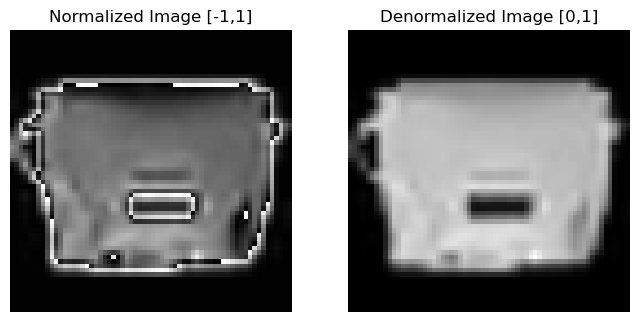

In [29]:
# Manual denormlisation of images
# Below, the other example uses torch utils (make grid) to denormalise from tensors to images
def denorm(x):
    """Denormalize the outputs from [-1, 1] to [0,1] (generator with 'tanh' activation)"""
    return (x * 0.5) + 0.5

for i, t in enumerate(dataloader):
    x, y = t
    img = transforms.ToPILImage()(x[0])
    a = denorm(x[0])
    img_denorm = transforms.ToPILImage()(a)

    # Create a side-by-side plot
    fig, axes = plt.subplots(1, 2, figsize=(8, 4))

    axes[0].imshow(img, cmap='gray')
    axes[0].set_title("Normalized Image [-1,1]")
    axes[0].axis("off")

    axes[1].imshow(img_denorm, cmap='gray')
    axes[1].set_title("Denormalized Image [0,1]")
    axes[1].axis("off")

    plt.show()
    break  # Stop after displaying one batch



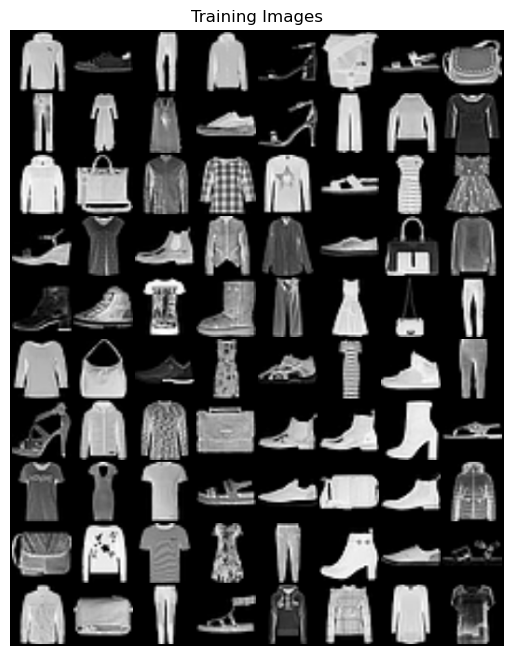

In [30]:
for i, t in enumerate(dataloader):
    x, y = t
    # Use make_grid to automatically normalize the images for visualization
    # Take 8 images for visualization
    img_grid = vutils.make_grid(x[:80], padding=2, normalize=True).cpu()  

    # Convert tensor to numpy format for plotting
    img_np = np.transpose(img_grid, (1, 2, 0))  # Convert (C, H, W) → (H, W, C)

    # Display the images
    plt.figure(figsize=(8, 8))
    plt.axis("off")
    plt.title("Training Images")
    plt.imshow(img_np, cmap="gray")
    plt.show()

    # Stop after displaying one batch
    break  

#### Observe your Batches

In [31]:
# Why do we see this difference of numbers here? shouldnt they return the same total number of images?

print(f"{len(dataloader)} batches, of {batch_size} images each, therefore {len(dataloader)*batch_size} in total")
print(f"vs {len(dataset)} images when we iterate over the dataset directly")

# Go back to your dataloader and change drop_last=True and see the difference in the number of images

468 batches, of 128 images each, therefore 59904 in total
vs 60000 images when we iterate over the dataset directly


#### GAN Architecture

In the following two cells, we define the architecture of the generator and discriminator network, respectively:

In [ ]:
# the generator takes in a random noise vector (z) and generates an image through a series of transpose convolution layers

class Generator(nn.Module):
    def __init__(self, z_dim, img_channels, features_g):
        super(Generator, self).__init__()

        # performs transpose conv or deconvolution (upsampling) to increase spatial dimensions of the input tensor
        self.conv1 = nn.ConvTranspose2d(z_dim, features_g * 8, kernel_size=4, stride=1, padding=0, bias=False)
        self.conv2 = nn.ConvTranspose2d( features_g * 8, features_g * 4, 4, 2, 1, bias=False)
        self.conv3 = nn.ConvTranspose2d( features_g * 4, features_g * 2, 4, 2, 1, bias=False)
        self.conv4 = nn.ConvTranspose2d( features_g * 2, features_g, 4, 2, 1, bias=False)
        self.conv5 = nn.ConvTranspose2d( features_g, img_channels, 4, 2, 1, bias=False)
        # batch norm layers to stabilize training
        self.bn1 = nn.BatchNorm2d(features_g * 8)
        self.bn2 = nn.BatchNorm2d(features_g * 4)
        self.bn3 = nn.BatchNorm2d(features_g * 2)
        self.bn4 = nn.BatchNorm2d(features_g)

    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = self.bn1(x)
        x = F.relu(self.conv2(x))
        x = self.bn2(x)
        x = F.relu(self.conv3(x))
        x = self.bn3(x)
        x = F.relu(self.conv4(x))
        x = self.bn4(x)
        x = F.tanh(self.conv5(x))
        return x

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, img_channels, features_d):
        super(Discriminator, self).__init__()
        # performs a series of convolutions to reduce spatial dimensions of the input tensor | downsampling vs upsampling in the generator
        self.conv1 = nn.Conv2d(img_channels, features_d, kernel_size=4, stride=2, padding=1, bias=False)
        self.conv2 = nn.Conv2d(features_d, features_d * 2, 4, 2, 1, bias=False)
        self.conv3 = nn.Conv2d(features_d * 2, features_d * 4, 4, 2, 1, bias=False)
        self.conv4 = nn.Conv2d(features_d * 4, features_d * 8, 4, 2, 1, bias=False)
        self.conv5 = nn.Conv2d(features_d * 8, 1, 4, 1, 0, bias=False)
        # batch norm layers to stabilize training
        self.bn1 = nn.BatchNorm2d(features_d * 2)
        self.bn2 = nn.BatchNorm2d(features_d * 4)
        self.bn3 = nn.BatchNorm2d(features_d * 8)

    def forward(self, x):
        x = F.leaky_relu(self.conv1(x))
        x = F.leaky_relu(self.conv2(x))
        x = self.bn1(x)
        x = F.leaky_relu(self.conv3(x))
        x = self.bn2(x)
        x = F.leaky_relu(self.conv4(x))
        x = self.bn3(x)
        # maps the final output to [0,1], representing the probability of the input being real (1.0) or fake (0.0) | binary classification
        x = F.sigmoid(self.conv5(x))
        return x

#### Weights Initialition

In [34]:
def initialize_weights(model):
    classname = model.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(model.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(model.weight.data, 1.0, 0.02)
        nn.init.constant_(model.bias.data, 0)

##### Setup G and D Networks

In the following two cells, we setup the core objects of our networks (weights, loss function, optimisation algorithm).

In [35]:
gen = Generator(z_dim, img_channels, feat_gen).to(device)
disc = Discriminator(img_channels, feat_discr).to(device)

# You may start with the random initialisation of weights,
# but if you wish to continue your training from a certain checkpoint, 
# you can load your saved model, i.e. weights, from that checkpoint
# and proceed from there.
# Change tour `new_training` boolean accordingly in the hyperparameters
if new_training == False:
    checkpoint = torch.load(dcgan_load_dir, map_location=torch.device(device))
    gen.load_state_dict(checkpoint['generator'])
    disc.load_state_dict(checkpoint['discriminator'])
else:
    gen.apply(initialize_weights)
    disc.apply(initialize_weights)

print(gen)
print(disc)

Generator(
  (conv1): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
  (conv2): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (conv3): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (conv4): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (conv5): ConvTranspose2d(64, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (bn1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (bn2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (bn3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (bn4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
)
Discriminator(
  (conv1): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (conv2): Conv2d(64, 128, kernel_size=(4, 4)

In [ ]:
# initialise the binary cross entropy loss function
criterion = nn.BCELoss()

# create batch of latent vectors that we will use to visualise | 64 random noise vectors in this case
# the progression of the generator
fixed_noise = torch.randn(64, z_dim, 1, 1, device=device) 

# establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# setup Adam optimisers for both G and D
opt_gen = optim.Adam(gen.parameters(), lr=learn_rate, betas=(0.5, 0.999))
opt_disc = optim.Adam(disc.parameters(), lr=learn_rate, betas=(0.5, 0.999))


#### Training Loop

Epoch [0/5] Batch 0/468                   loss D: 1.6627, loss G: 2.6398


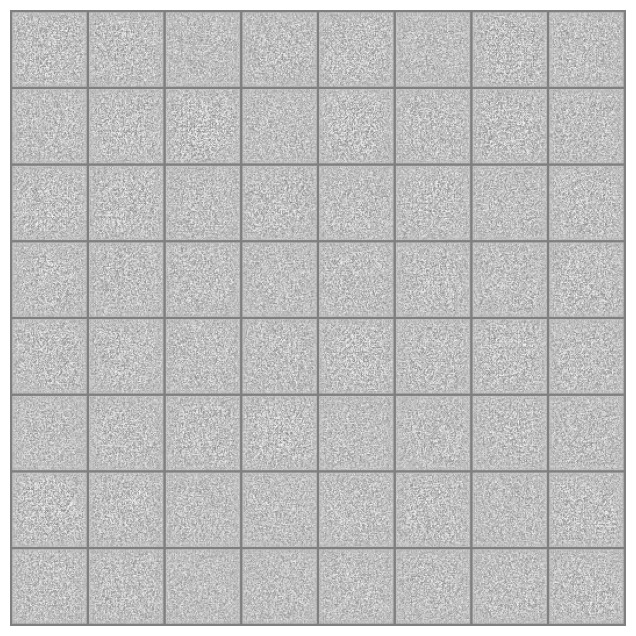

Epoch [0/5] Batch 50/468                   loss D: 0.0016, loss G: 9.2297


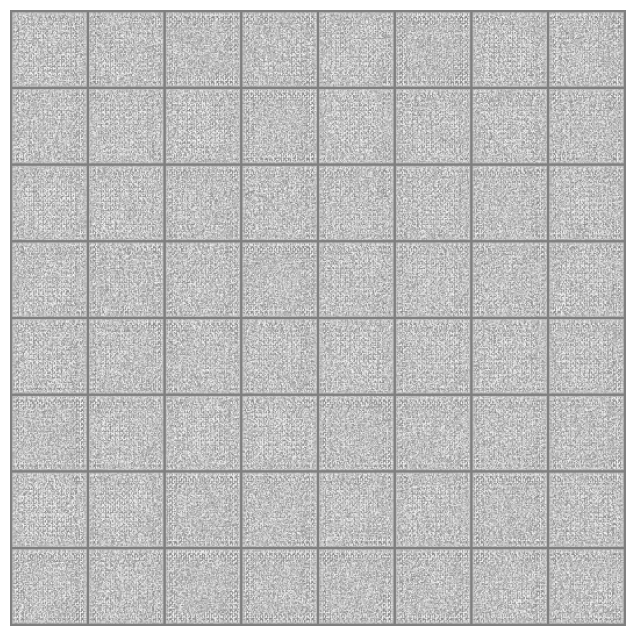

Epoch [0/5] Batch 100/468                   loss D: 0.0027, loss G: 9.3684


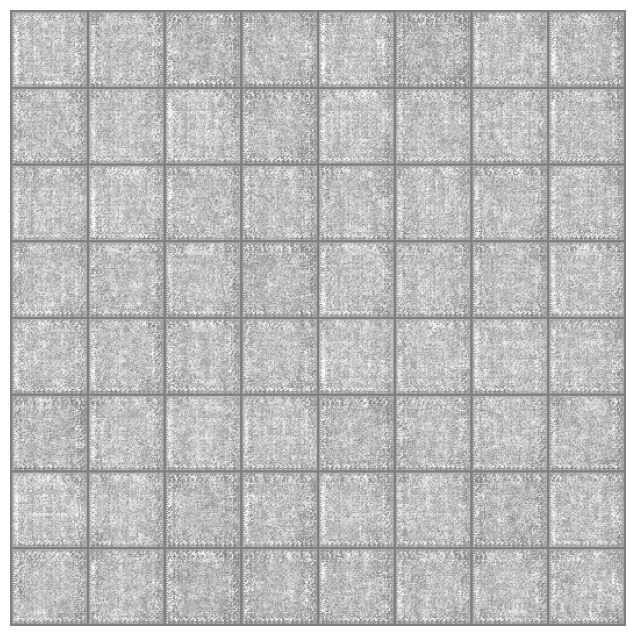

Epoch [0/5] Batch 150/468                   loss D: 0.2270, loss G: 9.8636


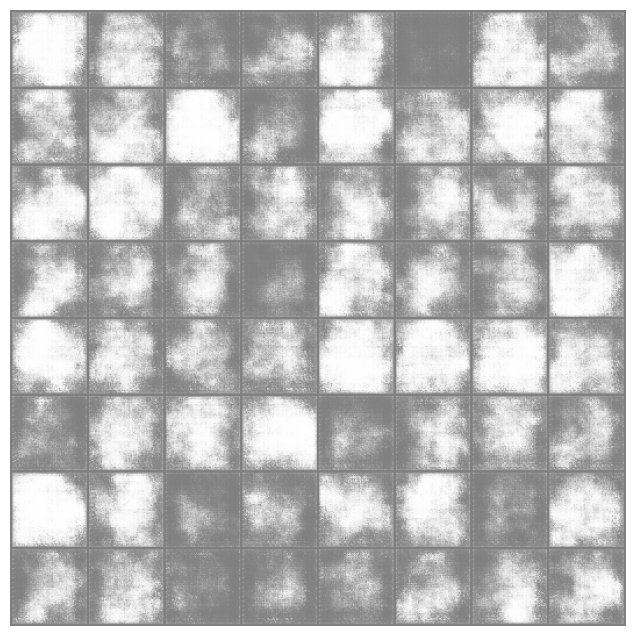

Epoch [0/5] Batch 200/468                   loss D: 0.0331, loss G: 5.9648


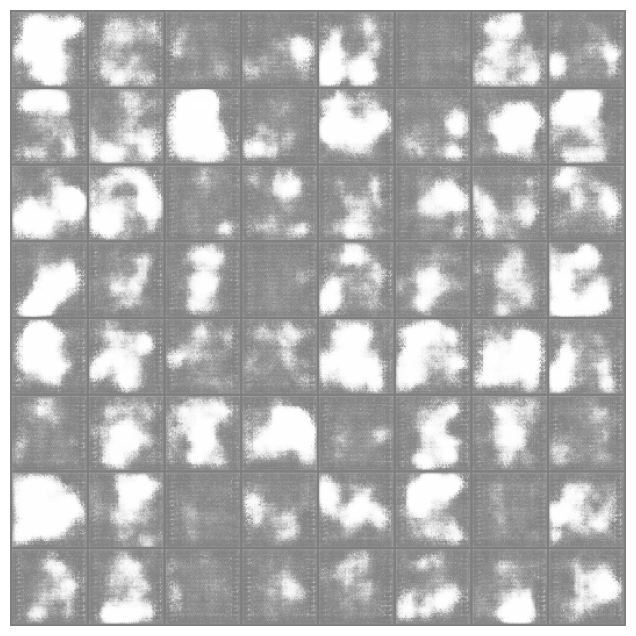

Epoch [0/5] Batch 250/468                   loss D: 0.1221, loss G: 4.6847


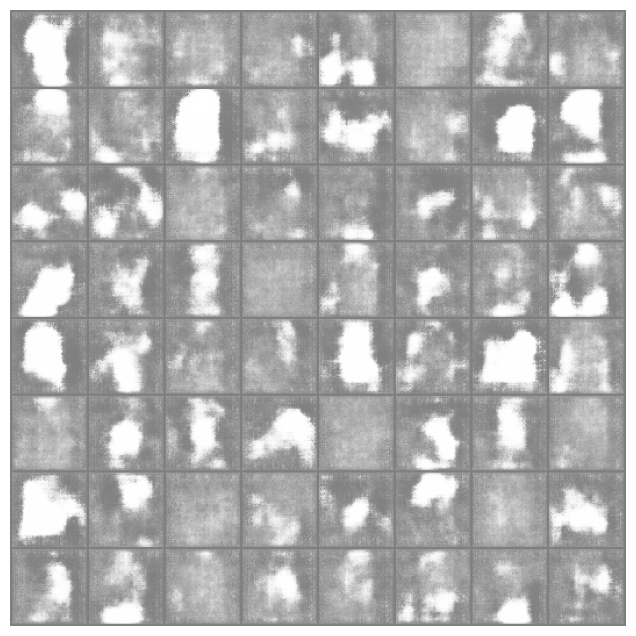

Epoch [0/5] Batch 300/468                   loss D: 0.0540, loss G: 5.1531


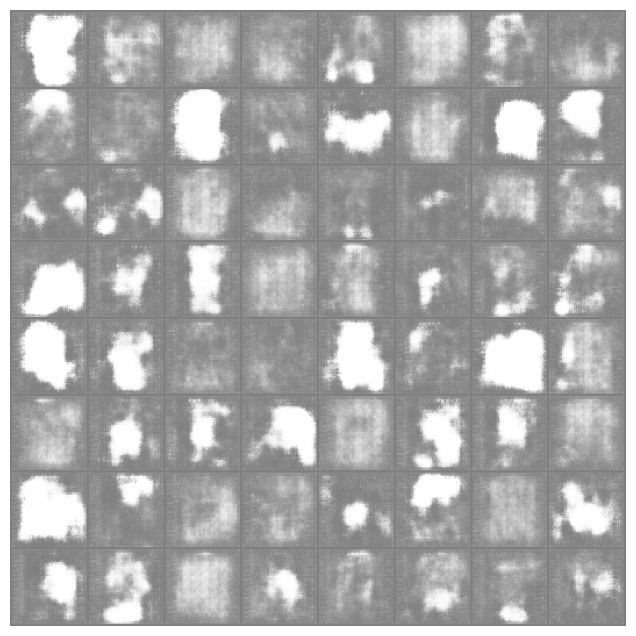

Epoch [0/5] Batch 350/468                   loss D: 0.0385, loss G: 4.6260


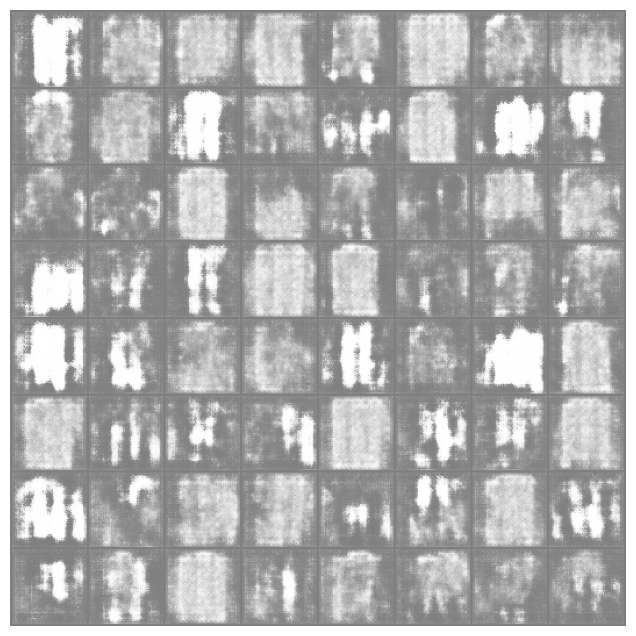

Epoch [0/5] Batch 400/468                   loss D: 0.2059, loss G: 4.7282


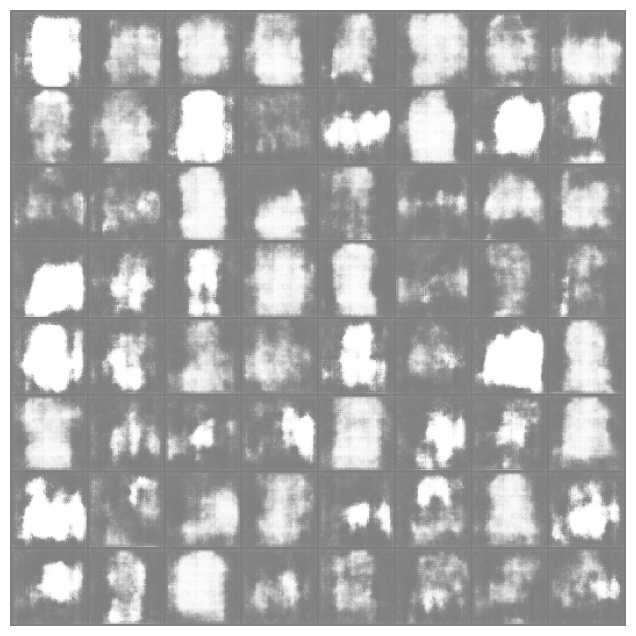

Epoch [0/5] Batch 450/468                   loss D: 0.0710, loss G: 4.6366


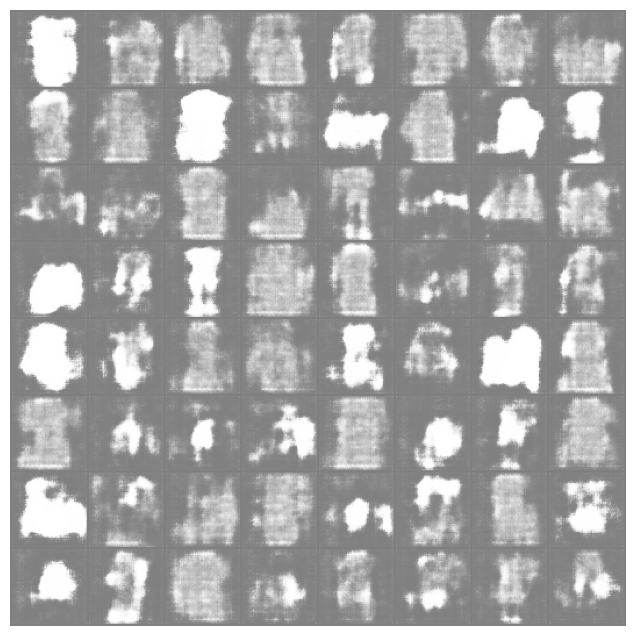

Epoch [1/5] Batch 0/468                   loss D: 0.1467, loss G: 5.0969


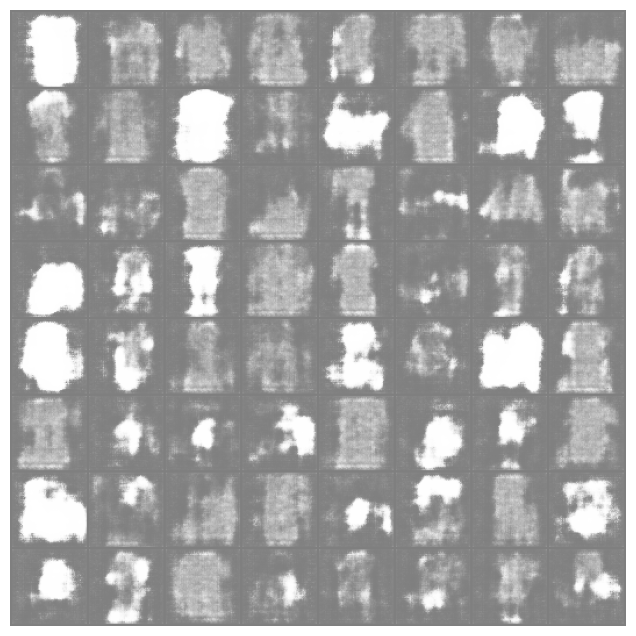

Epoch [1/5] Batch 50/468                   loss D: 0.0697, loss G: 4.5936


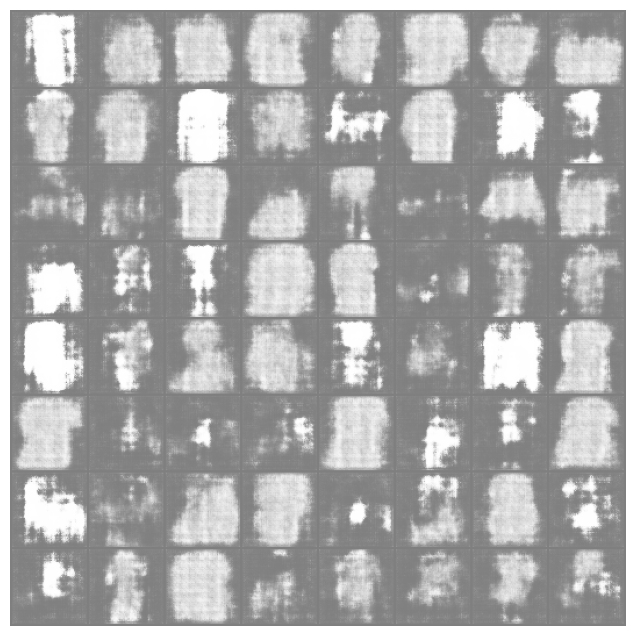

Epoch [1/5] Batch 100/468                   loss D: 0.3776, loss G: 3.2165


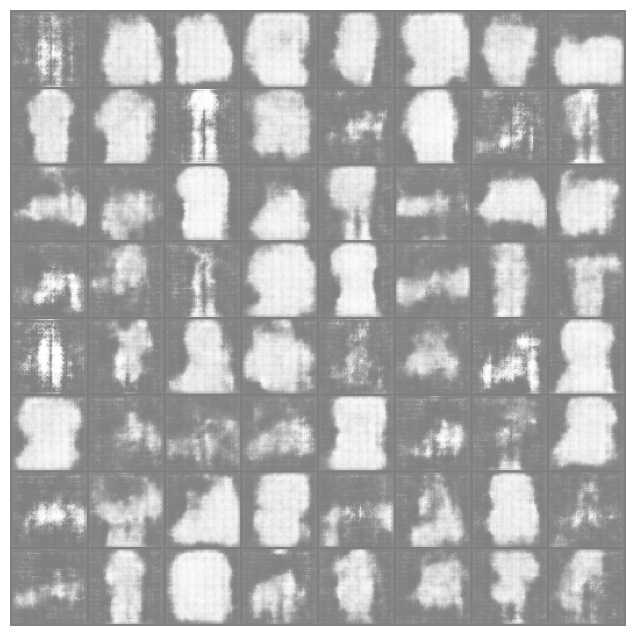

Epoch [1/5] Batch 150/468                   loss D: 0.3408, loss G: 4.4095


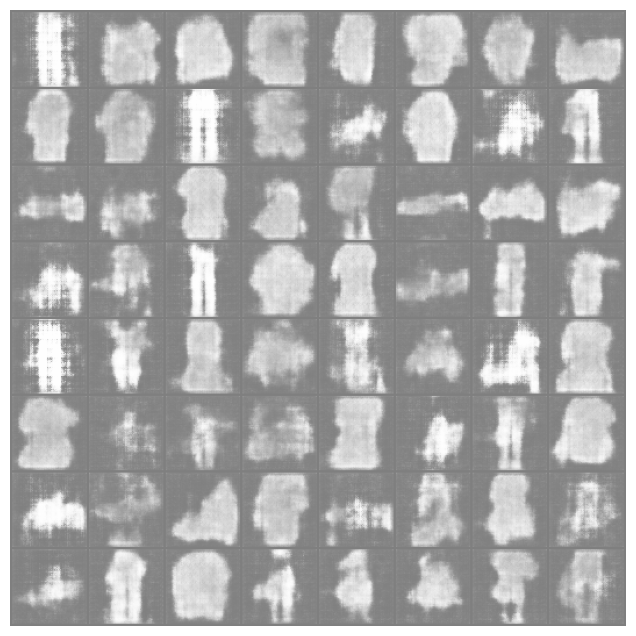

Epoch [1/5] Batch 200/468                   loss D: 0.1546, loss G: 4.8755


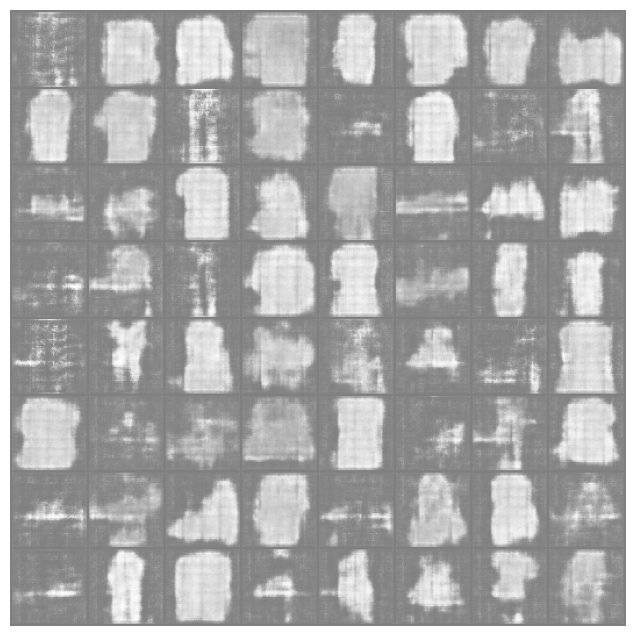

Epoch [1/5] Batch 250/468                   loss D: 0.1270, loss G: 5.3947


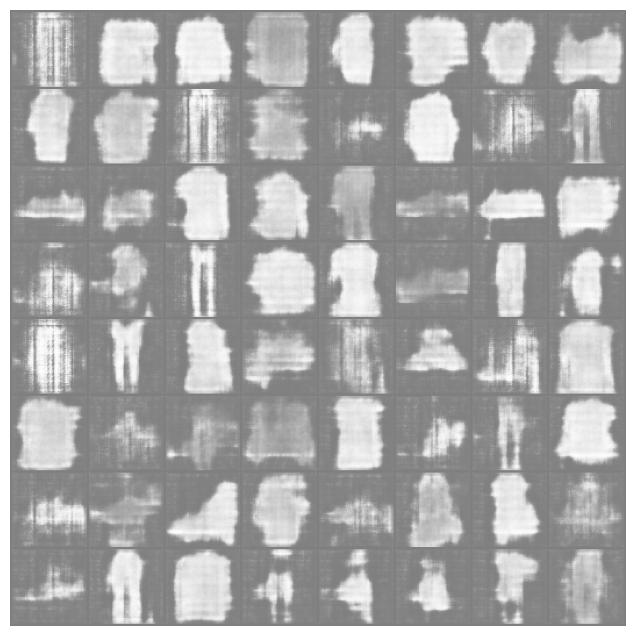

Epoch [1/5] Batch 300/468                   loss D: 0.1476, loss G: 3.7012


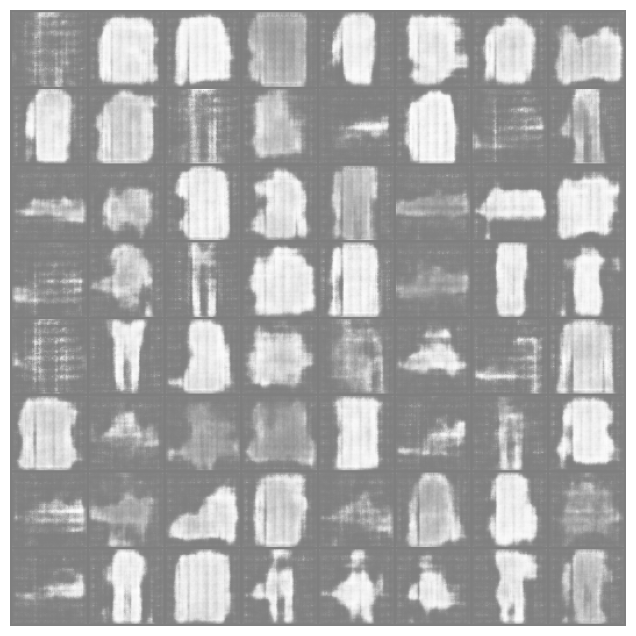

Epoch [1/5] Batch 350/468                   loss D: 1.4995, loss G: 5.2839


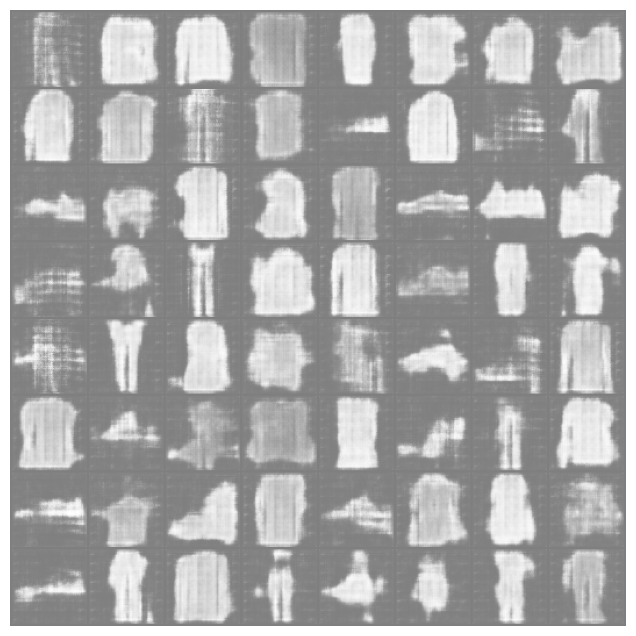

Epoch [1/5] Batch 400/468                   loss D: 0.1545, loss G: 4.3110


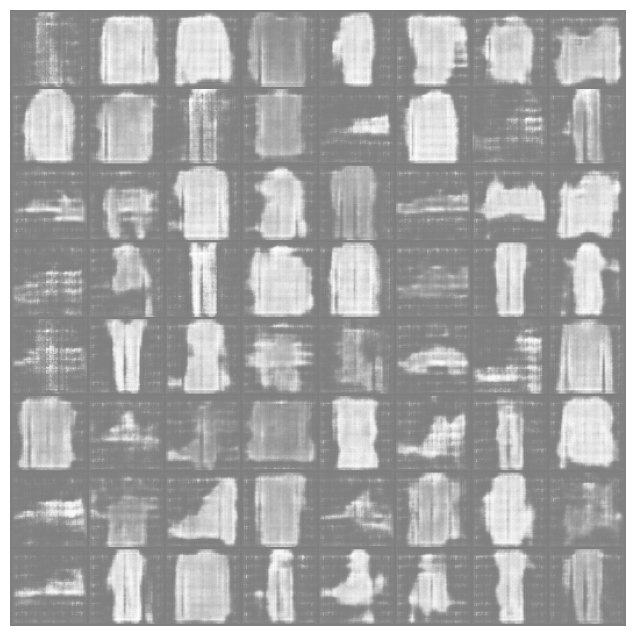

Epoch [1/5] Batch 450/468                   loss D: 0.3702, loss G: 3.6756


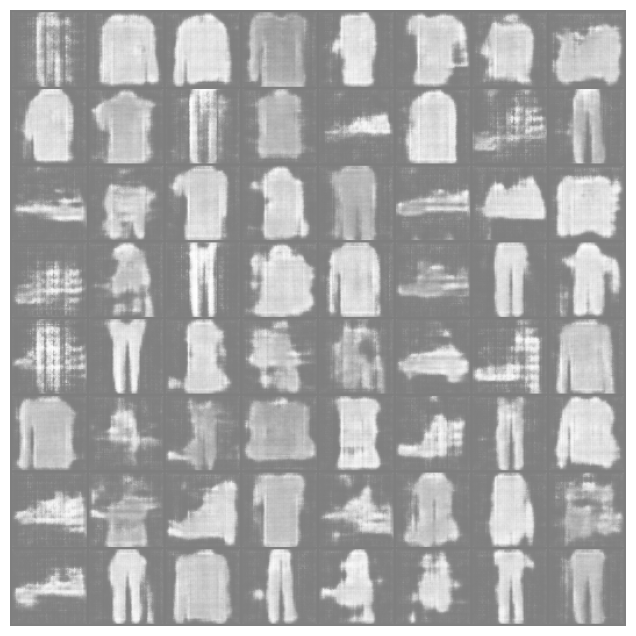

Epoch [2/5] Batch 0/468                   loss D: 0.1852, loss G: 4.3996


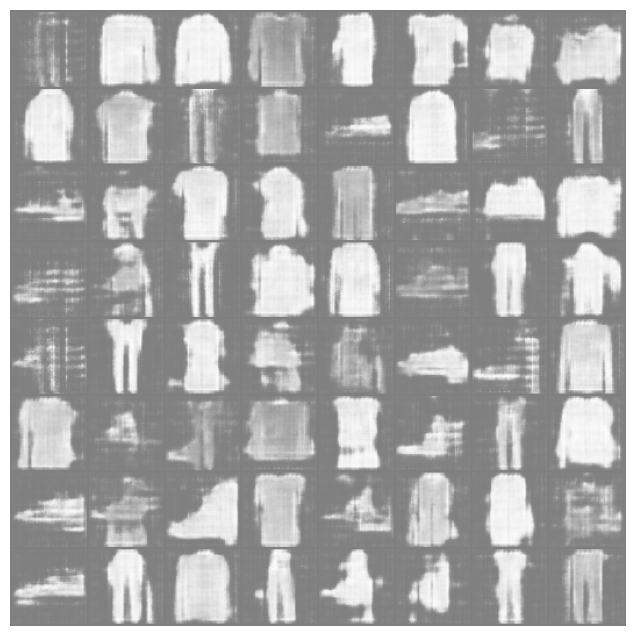

Epoch [2/5] Batch 50/468                   loss D: 0.2132, loss G: 3.7799


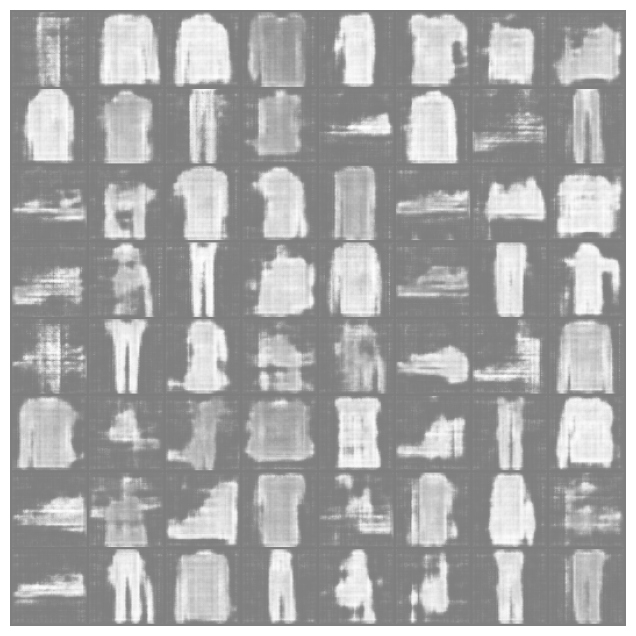

Epoch [2/5] Batch 100/468                   loss D: 0.5976, loss G: 8.6669


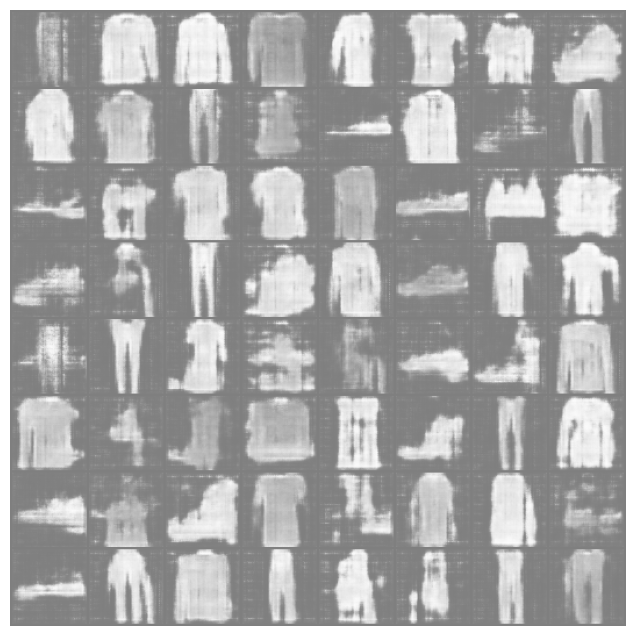

Epoch [2/5] Batch 150/468                   loss D: 1.0851, loss G: 3.3366


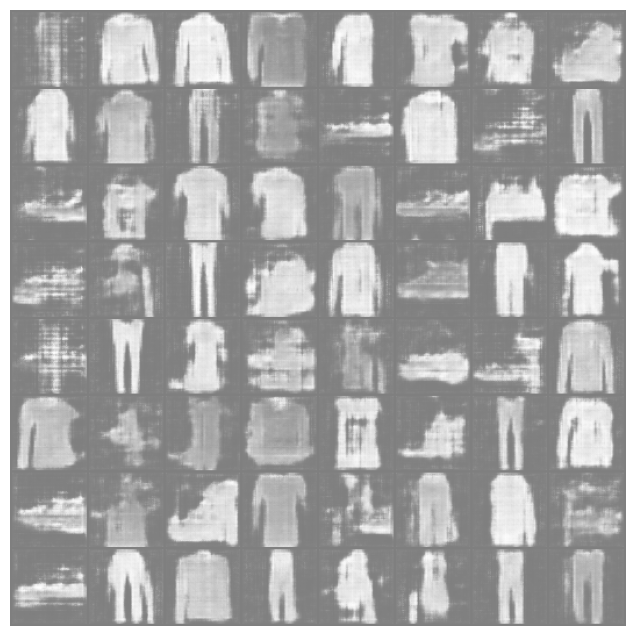

Epoch [2/5] Batch 200/468                   loss D: 0.1279, loss G: 3.5526


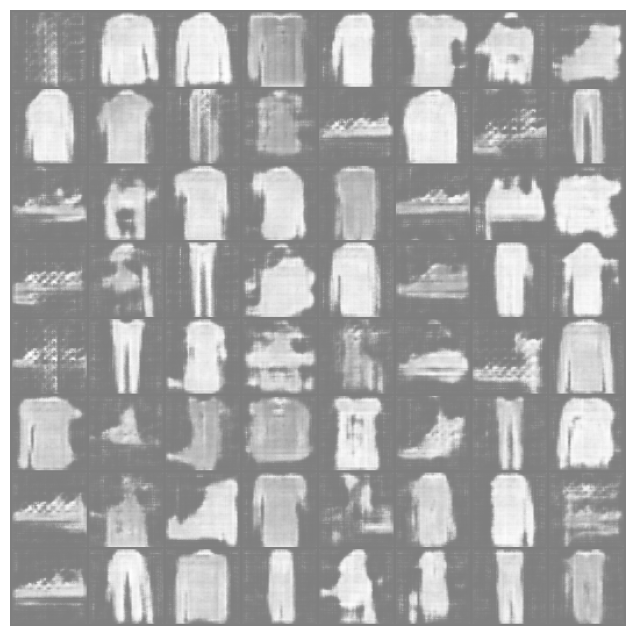

Epoch [2/5] Batch 250/468                   loss D: 0.1412, loss G: 4.4432


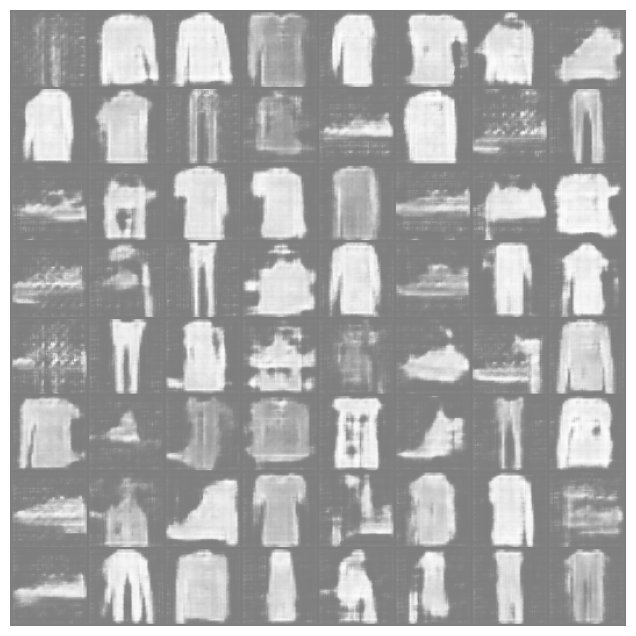

Epoch [2/5] Batch 300/468                   loss D: 0.4415, loss G: 7.6336


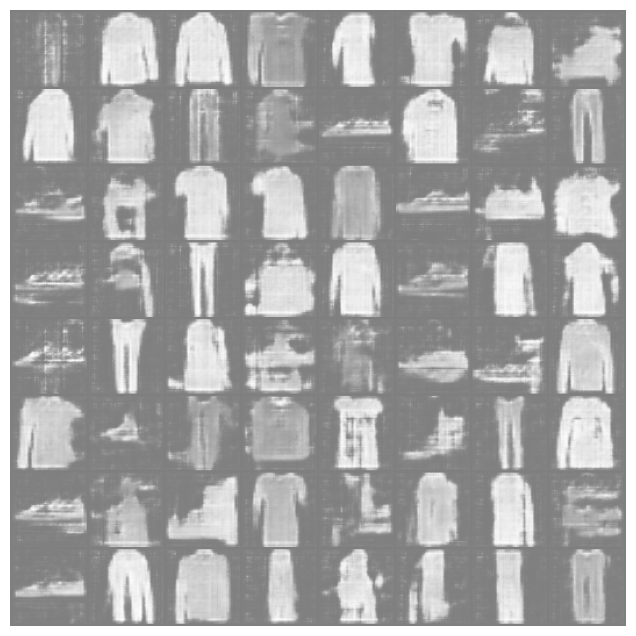

Epoch [2/5] Batch 350/468                   loss D: 0.1719, loss G: 4.7740


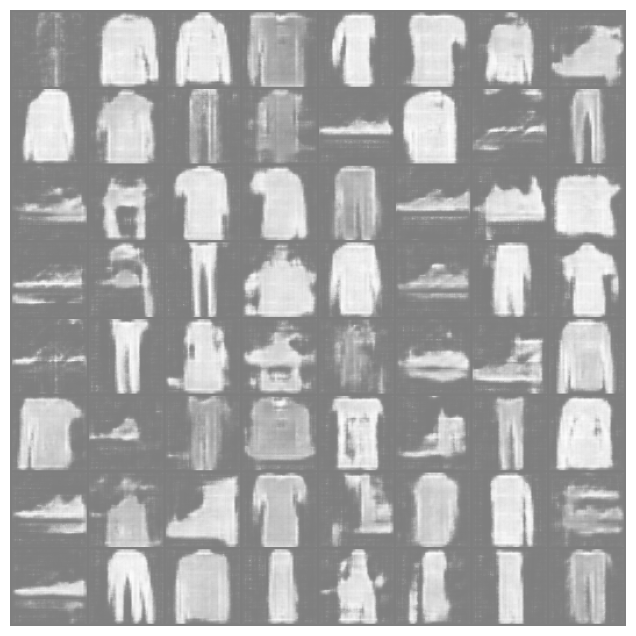

Epoch [2/5] Batch 400/468                   loss D: 0.0726, loss G: 4.8904


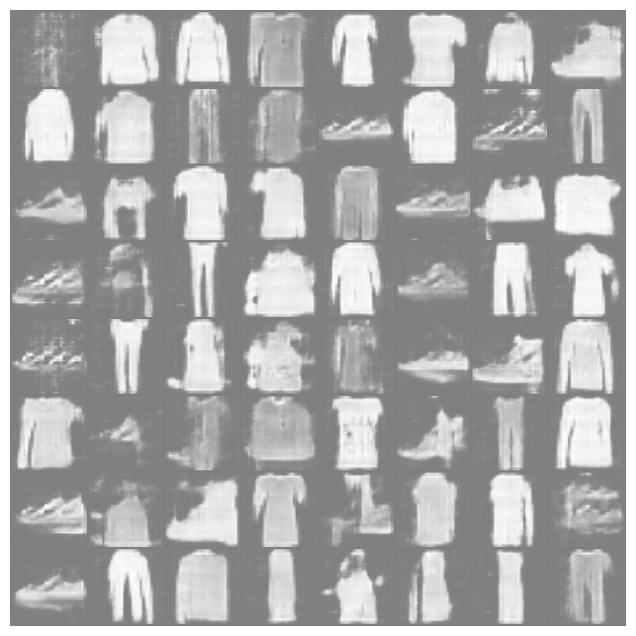

Epoch [2/5] Batch 450/468                   loss D: 0.1229, loss G: 4.0516


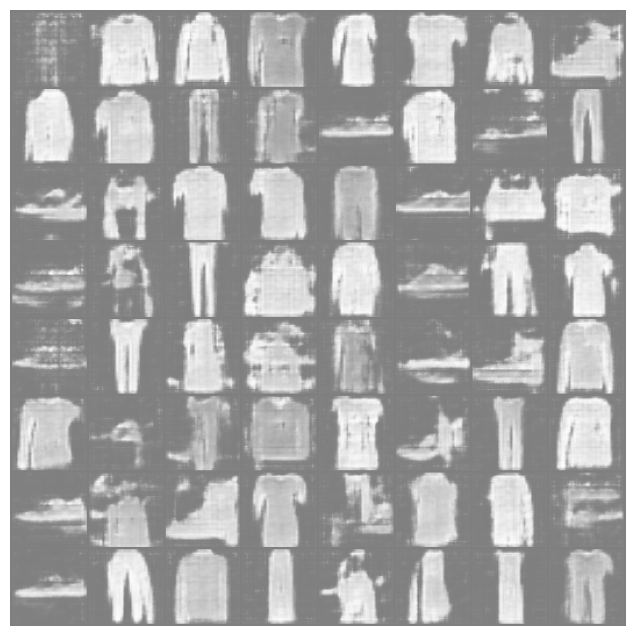

Epoch [3/5] Batch 0/468                   loss D: 0.1631, loss G: 4.8510


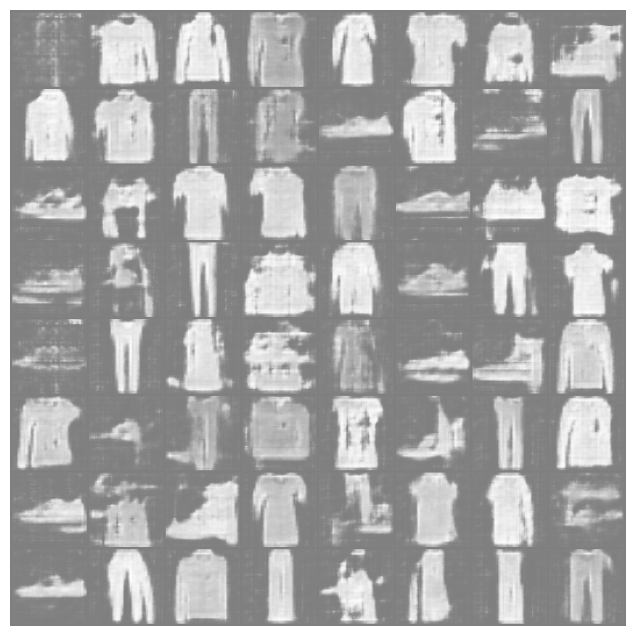

Epoch [3/5] Batch 50/468                   loss D: 0.1713, loss G: 3.7841


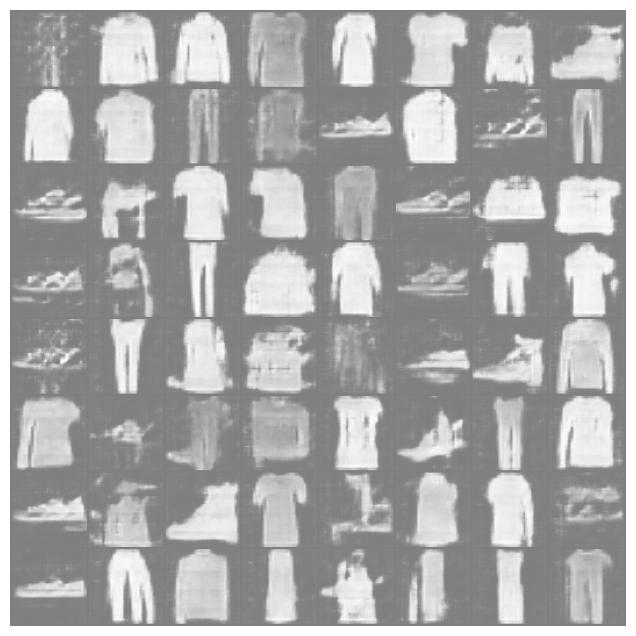

Epoch [3/5] Batch 100/468                   loss D: 1.2031, loss G: 5.3916


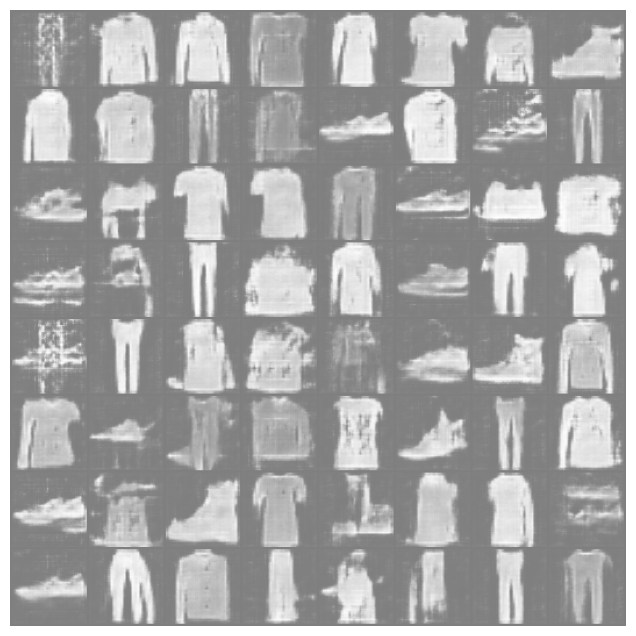

Epoch [3/5] Batch 150/468                   loss D: 0.3952, loss G: 2.9351


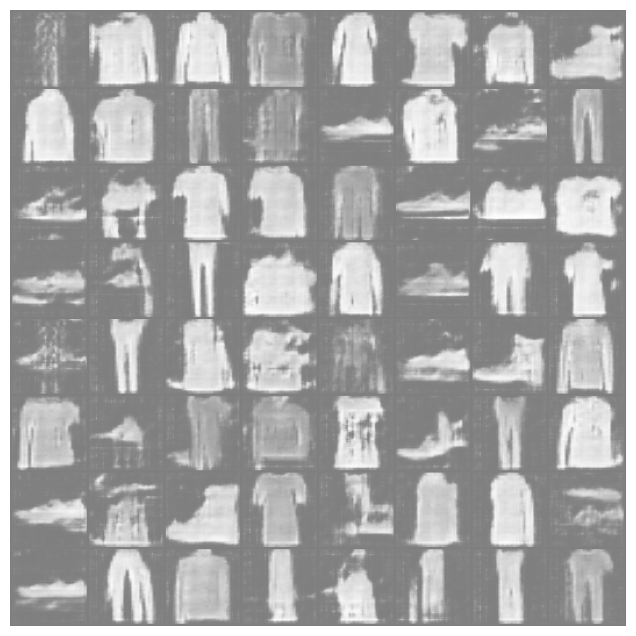

Epoch [3/5] Batch 200/468                   loss D: 0.1291, loss G: 4.6172


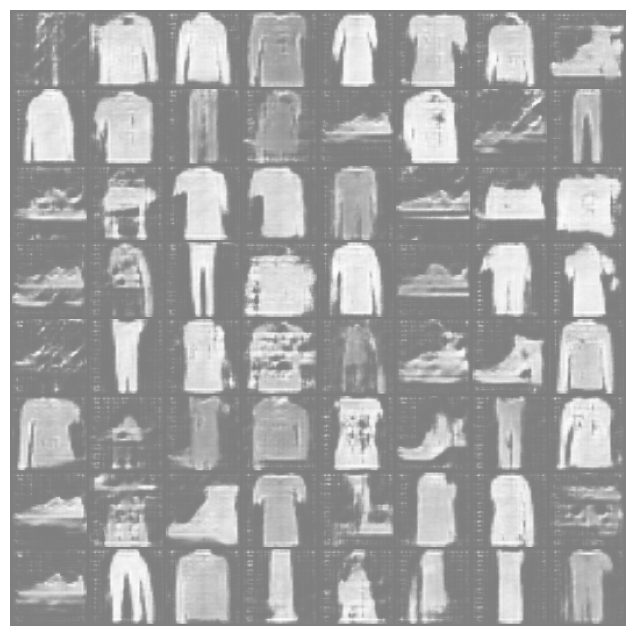

Epoch [3/5] Batch 250/468                   loss D: 0.9788, loss G: 5.4509


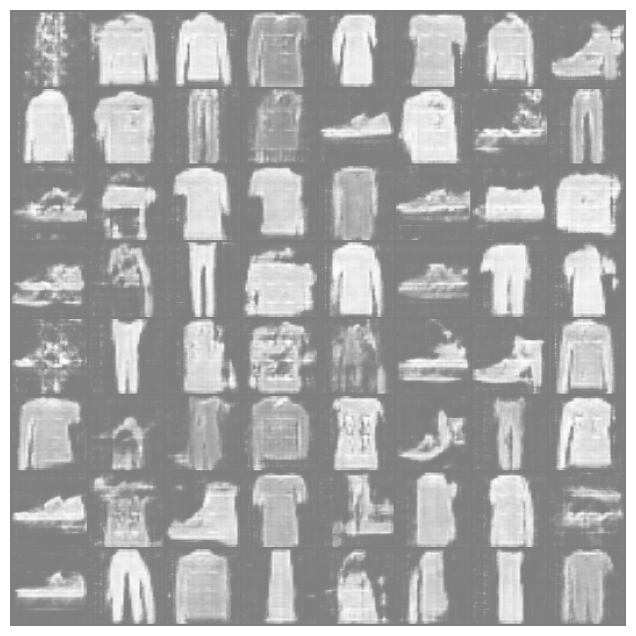

Epoch [3/5] Batch 300/468                   loss D: 0.0848, loss G: 4.2484


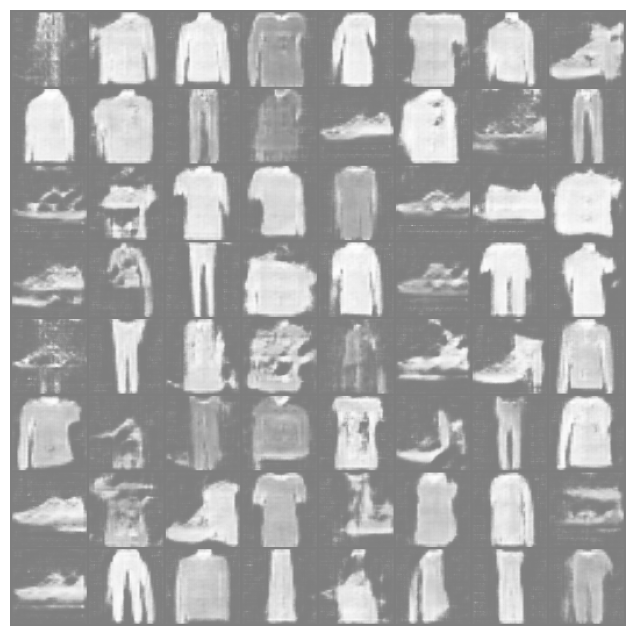

Epoch [3/5] Batch 350/468                   loss D: 0.0577, loss G: 4.3219


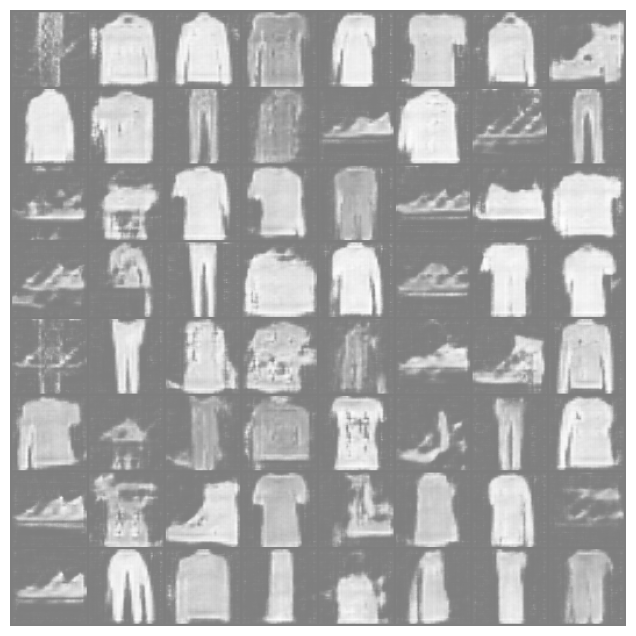

Epoch [3/5] Batch 400/468                   loss D: 0.6145, loss G: 5.1667


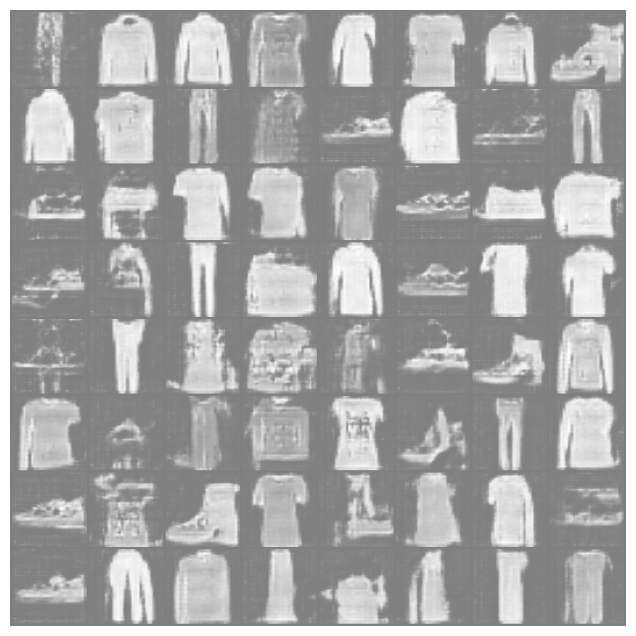

Epoch [3/5] Batch 450/468                   loss D: 0.1259, loss G: 4.3338


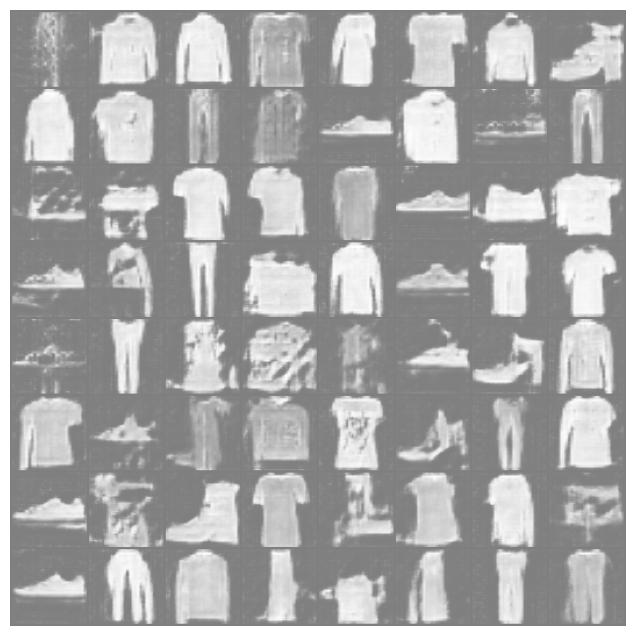

Epoch [4/5] Batch 0/468                   loss D: 0.1305, loss G: 5.1295


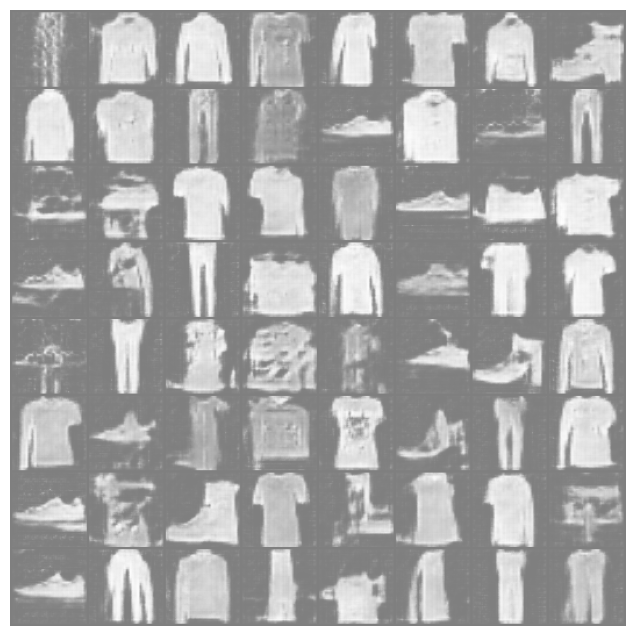

Epoch [4/5] Batch 50/468                   loss D: 0.3496, loss G: 4.1334


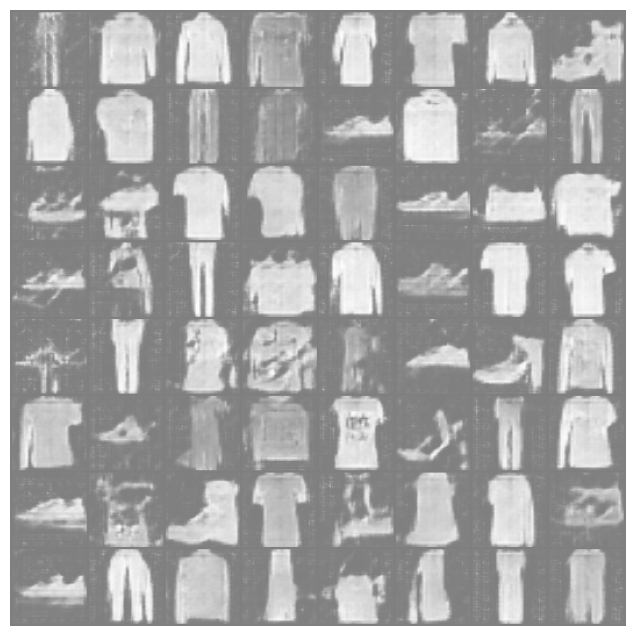

Epoch [4/5] Batch 100/468                   loss D: 3.0222, loss G: 0.9863


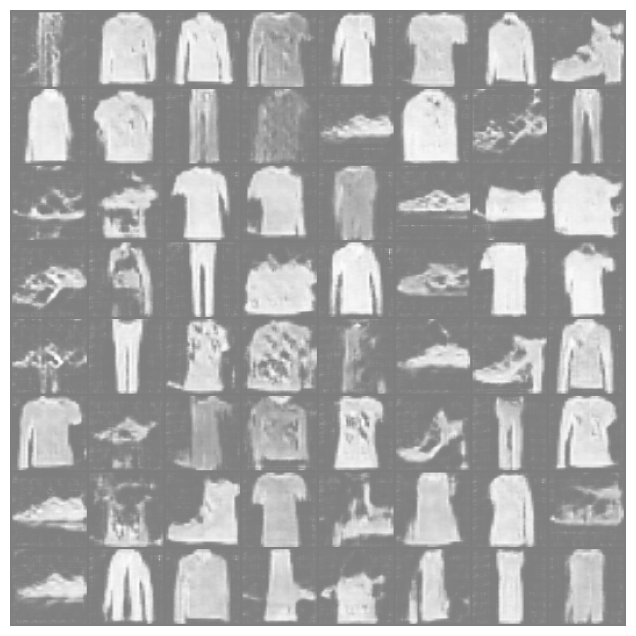

Epoch [4/5] Batch 150/468                   loss D: 0.2216, loss G: 3.0337


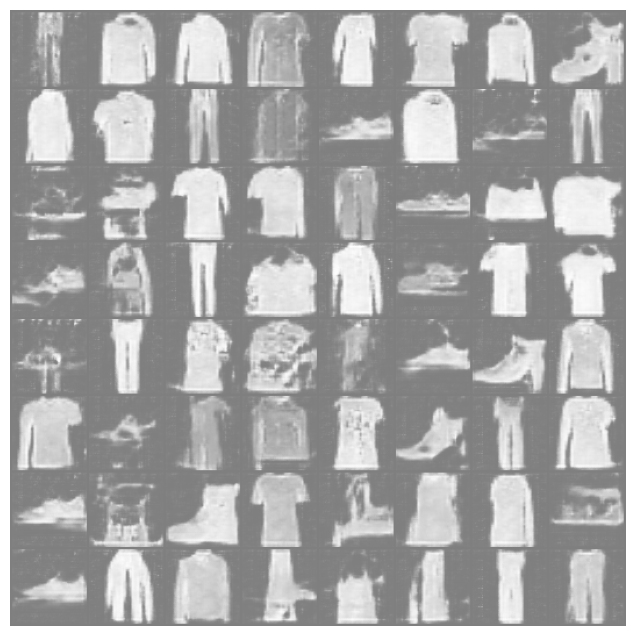

Epoch [4/5] Batch 200/468                   loss D: 0.2510, loss G: 5.9663


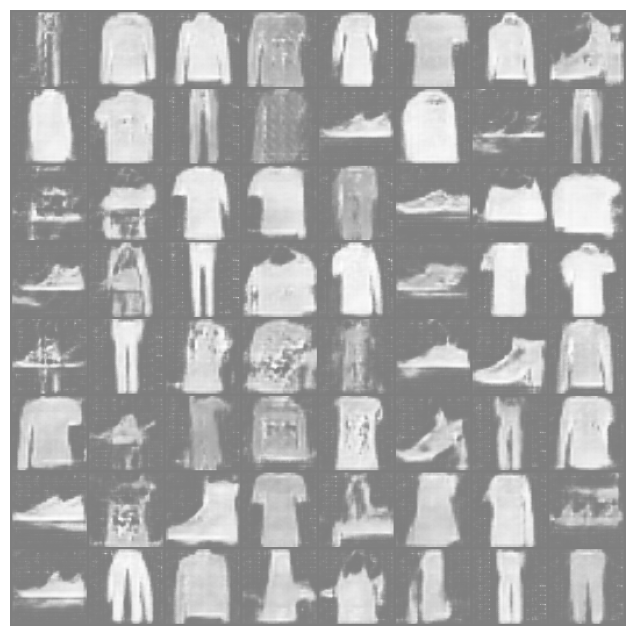

Epoch [4/5] Batch 250/468                   loss D: 0.1814, loss G: 4.1881


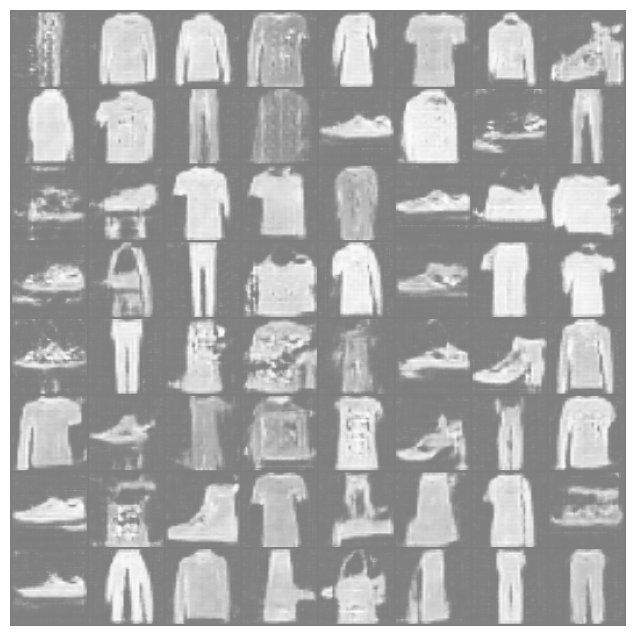

Epoch [4/5] Batch 300/468                   loss D: 0.2179, loss G: 4.8341


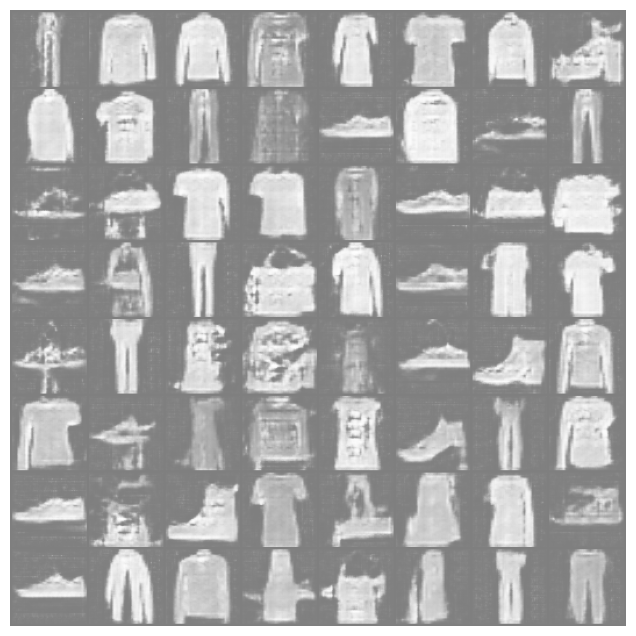

Epoch [4/5] Batch 350/468                   loss D: 0.0669, loss G: 5.0048


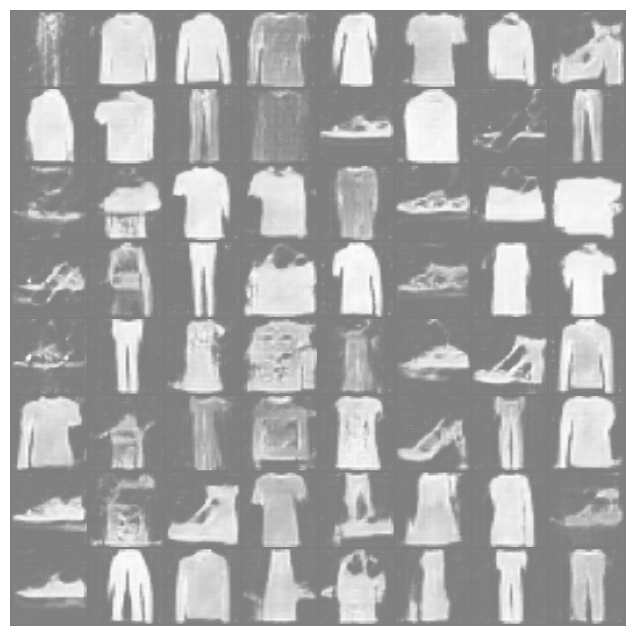

Epoch [4/5] Batch 400/468                   loss D: 0.1068, loss G: 5.2234


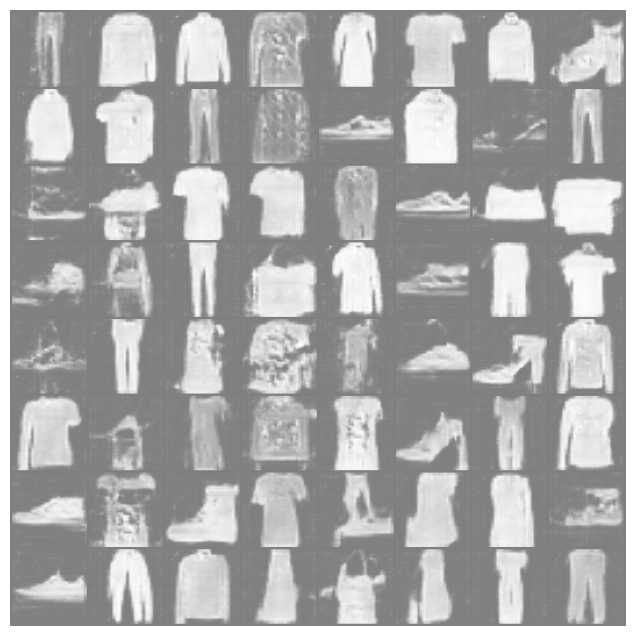

Epoch [4/5] Batch 450/468                   loss D: 0.1920, loss G: 4.7929


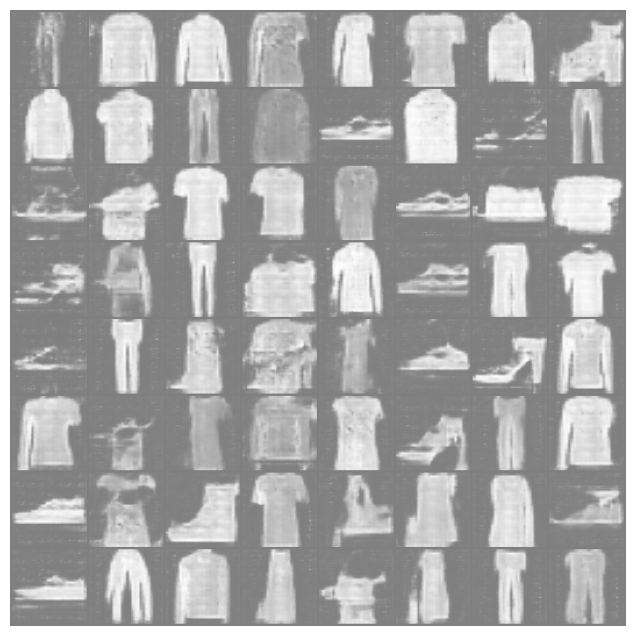

In [37]:
# lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

# for each epoch
for epoch in range(num_epochs):
    for batch_idx, (real_data, _ ) in enumerate(dataloader):
       
        # our dataloader returns the image data and the associated class labels '_' that we ignore
        # access batch of REAL DATA
        real_data = real_data.to(device)

        # generate batch of FAKE DATA
        noise = torch.randn((real_data.shape[0], z_dim, 1, 1)).to(device)
        fake_data = gen(noise)

        ###################################
        #### D I S C R I M I N A T O R ####
        ###################################

        # TRAIN WITH A BATCH OF REAL DATA
        # clear gradients of discriminator
        disc.zero_grad()
        # for the number of data in the real batch, create a real label 1
        real_data_size = real_data.size(0)
        label = torch.full((real_data_size,), real_label, dtype=torch.float, device=device)
        # forward pass real batch through the discriminator
        output = disc(real_data).squeeze()
        # calculate loss on real batch
        errD_real = criterion(output, label)
        # calculate gradients for discriminator in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        # TRAIN WITH A BATCH OF FAKE DATA
        # for the fake data that we generated through the generator - see above discriminator
        # add a fake label
        label.fill_(fake_label)
        # classify all fake batch with discriminator
        output = disc(fake_data.detach()).squeeze()
        # calculate loss on fake batch
        errD_fake = criterion(output, label)
        # calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
       
        # compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # update the weights of the discriminator network only
        opt_disc.step()

        ###########################
        #### G E N E R A T O R ####
        ###########################

        # clear gradients of generator
        gen.zero_grad()

        # take fake images and pass through
        # fake labels are real for generator cost
        label.fill_(real_label) 
        output = disc(fake_data).squeeze()
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item() 
        
        # update generator weights only
        opt_gen.step()

        ############################################
        #### T R A C K I N G    P R O G R E S S ####
        ############################################

        # print losses and fake images occasionally
        if batch_idx % 50 == 0:
            print(
                f"Epoch [{epoch}/{num_epochs}] Batch {batch_idx}/{len(dataloader)} \
                  loss D: {errD:.4f}, loss G: {errG:.4f}"
            )
            with torch.no_grad():
                fake_data = gen(fixed_noise)
                img_grid_fake = make_grid(fake_data[:64], normalize=True)
                # img_list is for later use in creating a gif
                img_list.append(img_grid_fake)

                # convert to NumPy format for saving images
                image_unflat = (img_grid_fake + 1) / 2  # Rescale to [0,1]
                image_unflat = image_unflat.cpu().permute(1, 2, 0).numpy()  # Convert (C, H, W) → (H, W, C)

                # save images and show respective plot
                plt.figure(figsize=(8, 8))
                plt.imshow(image_unflat)
                plt.axis("off")
                plt.savefig(gen_images_dir / f"epoch_{epoch}_batch_{batch_idx:04d}.png")
                plt.show()
                plt.close()

        # save losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

#### Plot Losses

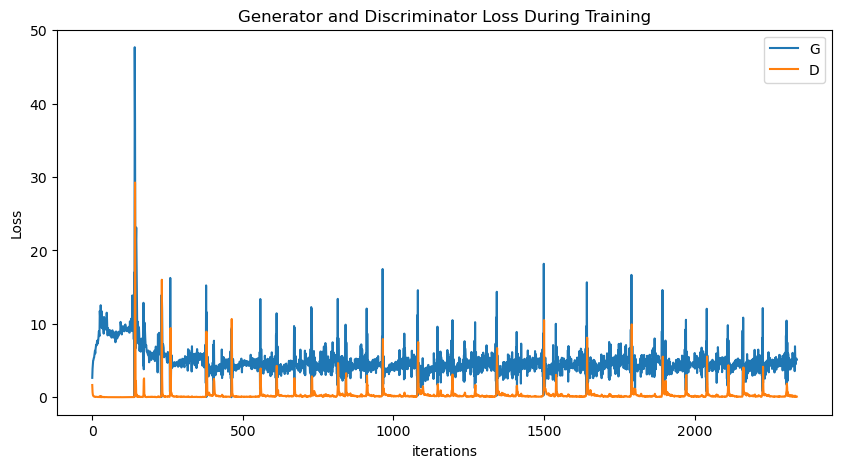

In [38]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

#### Save Model

In [39]:
# save model weights
model = {}
model['generator'] = gen.state_dict()
model['discriminator'] = disc.state_dict()
torch.save(model, dcgan_dir / f"{model_name}-2.pt")

#### Visualise the Results from your Training

The following 2 approches to creating a short video or GIF out of your generated images, were borrowed from [Jeremie Wegner's sister repo](https://github.com/jchwenger/DMLCP/blob/main/python/05_dcgan_training.ipynb).

The first approach is using matplotlib for generating a video, while the second one is using imageio for a GIF.

In [40]:
import matplotlib.animation as animation
from IPython.display import HTML
from IPython.display import Video

In [41]:
fig = plt.figure(figsize=(12,12))
plt.axis("off")
img_list_cpu = [i.cpu().detach().numpy().transpose(1, 2, 0) for i in img_list]  # Convert all tensors to NumPy

# Create animation frames using CPU-based images
ims = [[plt.imshow(i, animated=True)] for i in img_list_cpu]

ani = animation.ArtistAnimation(
    fig, ims, interval=100, # determines the speed
    repeat_delay=1000, blit=True
)
plt.close(fig) # Close the figure to avoid displaying a static image (ChatGPT 4o)

# .gif also possible
ani.save(gen_images_dir / "grid.mp4", writer="ffmpeg", dpi=80)

Video(gen_images_dir / "grid.mp4", embed=True)

In [42]:
import PIL
import base64
import textwrap
import mimetypes
import imageio as iio

In [43]:
# Display a single image using the epoch number
def display_image(epoch_num, batch_num):
    return PIL.Image.open(
        gen_images_dir / f"epoch_{epoch_num}_batch_{batch_num:04d}.png"
    ).convert('RGB')

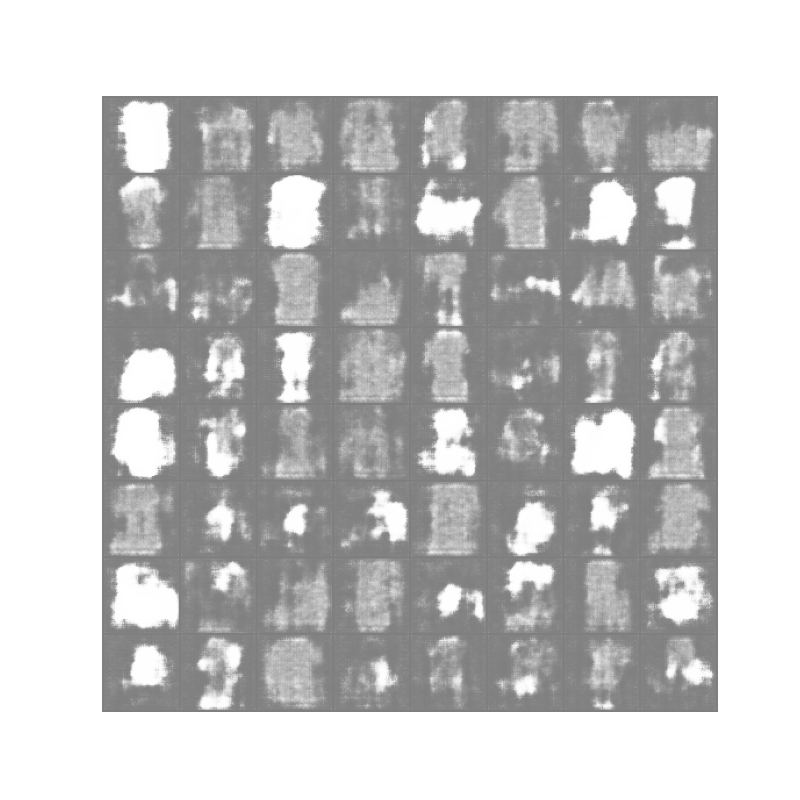

In [44]:
display_image(1, 0) # check the directory for the correct number

In [45]:
ANIM_PATH = gen_images_dir / 'grid_redux.gif'

# adapting the tutorial version to v3 + looping the gif 
with iio.get_writer(ANIM_PATH, mode='I', loop=0) as writer:
    for f in sorted(gen_images_dir.glob('epoch*.png')):
        image = iio.v3.imread(f)
        writer.append_data(image)


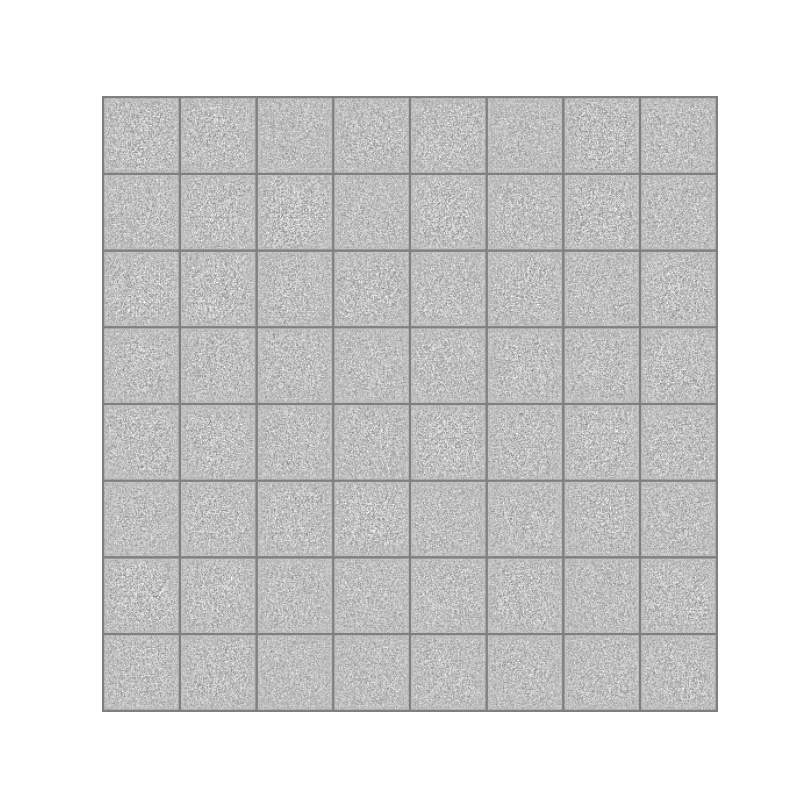

In [46]:
# adapted from here: https://github.com/tensorflow/docs/blob/master/tools/tensorflow_docs/vis/embed.py

def embed_data(mime, data):
    """Embeds data as an html tag with a data-url."""
    b64 = base64.b64encode(data).decode()
    if mime.startswith('image'):
        tag = f'<img src="data:{mime};base64,{b64}"/>'
    elif mime.startswith('video'):
        tag = textwrap.dedent(f"""
            <video width="640" height="480" controls>
              <source src="data:{mime};base64,{b64}" type="video/mp4">
              Your browser does not support the video tag.
            </video>
            """)
    else:
        raise ValueError('Images and Video only.')
    return HTML(tag)

def embed_file(path):
    """Embeds a file in the notebook as an html tag with a data-url."""
    path = pathlib.Path(path)
    mime, unused_encoding = mimetypes.guess_type(str(path))
    data = path.read_bytes()
    return embed_data(mime, data)

embed_file(ANIM_PATH)